## Notebook for exploratory analysis of Human Gut Stem cells scRNA-Seq data using `scVI` and `SCCAF-leiden`

- **Developed by**: Carlos Talavera-López Ph.D
- **Institute of Computational Biology - Computational Health Centre - Helmholtz Munich**
- v230315

### Load required modules

In [1]:
import sys
import scvi
import torch
import anndata
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns

import numpy as np
import scipy as sp
import pandas as pd
import scanpy as sc
import numpy.random as random


from umap import UMAP
import warnings; warnings.simplefilter('ignore')

import matplotlib.pyplot as plt

/Users/anna.maguza/miniconda3/envs/scvi_env/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Global seed set to 0
/Users/anna.maguza/miniconda3/envs/scvi_env/lib/python3.9/site-packages/flax/struct.py:132: FutureWarning: jax.tree_util.register_keypaths is deprecated, and will be removed in a future release. Please use `register_pytree_with_keys()` instead.
  jax.tree_util.register_keypaths(data_clz, keypaths)
/Users/anna.maguza/miniconda3/envs/scvi_env/lib/python3.9/site-packages/flax/struct.py:132: FutureWarning: jax.tree_util.register_keypaths is deprecated, and will be removed in a future release. Please use `register_pytree_with_keys()` instead.
  jax.tree_util.register_keypaths(data_clz, keypaths)
/Users/anna.maguza/miniconda3/envs/scvi_env/lib/python3.9/site-packages/flax/struct.py:132: FutureWarnin

In [2]:
%matplotlib inline
matplotlib.rcParams["pdf.fonttype"] = 42
matplotlib.rcParams["ps.fonttype"] = 42

In [3]:
torch.cuda.is_available()

False

In [4]:
torch.set_float32_matmul_precision('medium')

In [5]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 180, color_map = 'magma_r', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.8.0
scanpy      1.9.3
-----
PIL                         9.4.0
absl                        NA
appnope                     0.1.2
asttokens                   NA
attr                        22.2.0
backcall                    0.2.0
beta_ufunc                  NA
binom_ufunc                 NA
brotli                      NA
certifi                     2022.12.07
cffi                        1.15.1
charset_normalizer          2.1.1
chex                        0.1.6
colorama                    0.4.6
comm                        0.1.2
contextlib2                 NA
cycler                      0.10.0
cython_runtime              NA
dateutil                    2.8.2
debugpy                     1.5.1
decorator                   5.1.1
defusedxml                  0.7.1
docrep                      0.3.2
entrypoints                 0.4
executing                   0.8.3
flax                        0.6.1
fsspec                      2023.3.0
h5py                        3.8.0
hypergeom_uf

In [7]:
def X_is_raw(adata):
    return np.array_equal(adata.X.sum(axis=0).astype(int), adata.X.sum(axis=0))

### Read in datasets

- Read in formatted object

In [8]:
gut_stem = sc.read_h5ad('/Users/anna.maguza/Desktop/Data/Processed_datasets/Predicted_stem_cells/Predicted_stem_cells.h5ad')
gut_stem

AnnData object with n_obs × n_vars = 14938 × 40144
    obs: 'UniqueCell_ID', 'Sample_ID', 'CellType', 'Study_name', 'Donor_ID', 'Diagnosis', 'Age', 'Region code', 'Fraction', 'Gender', '10X', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts_mt', 'doublet_scores', 'predicted_doublets', 'Age_group', 'total_counts_ribo', 'Location', 'n_counts', 'percent_mito', 'percent_ribo', 'Cell States', 'Cell Label'

In [9]:
sc.pp.filter_genes(gut_stem, min_counts = 1)
sc.pp.filter_genes(gut_stem, min_cells = 3)

sc.pp.filter_cells(gut_stem, min_genes = 50)
sc.pp.filter_cells(gut_stem, min_counts = 3)

filtered out 11320 genes that are detected in less than 1 counts
filtered out 4187 genes that are detected in less than 3 cells


In [10]:
gut_stem.obs['Study_name'].cat.categories

Index(['Gut Cell Atlas', 'Smilie', 'Wang'], dtype='object')

In [11]:
X_is_raw(gut_stem)

True

### Calculate HVGs

In [12]:
gut_stem_raw = gut_stem.copy()
gut_stem.layers['counts'] = gut_stem.X.copy()

In [13]:
sc.pp.highly_variable_genes(
    gut_stem,
    flavor = "seurat_v3",
    n_top_genes = 7000,
    layer = "counts",
    batch_key = "Fraction",
    subset = True,
    span = 1
)
gut_stem

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


AnnData object with n_obs × n_vars = 14938 × 7000
    obs: 'UniqueCell_ID', 'Sample_ID', 'CellType', 'Study_name', 'Donor_ID', 'Diagnosis', 'Age', 'Region code', 'Fraction', 'Gender', '10X', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts_mt', 'doublet_scores', 'predicted_doublets', 'Age_group', 'total_counts_ribo', 'Location', 'n_counts', 'percent_mito', 'percent_ribo', 'Cell States', 'Cell Label'
    var: 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'hvg'
    layers: 'counts'

### Data integration with `scVI`

In [14]:
scvi.model.SCVI.setup_anndata(
    gut_stem,
    layer = "counts",
    categorical_covariate_keys = ["Fraction"],
    continuous_covariate_keys = ["n_genes", "n_counts"]
)

In [15]:
model = scvi.model.SCVI(gut_stem, n_layers = 3, n_latent = 50, gene_likelihood = "nb", dispersion = 'gene-batch')
model

SCVI Model with the following params: 
n_hidden: 128, n_latent: 50, n_layers: 3, dropout_rate: 0.1, dispersion: gene-batch, gene_likelihood: nb, 
latent_distribution: normal
Training status: Not Trained
Model's adata is minified?: False

In [16]:
model.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Epoch 400/400: 100%|██████████| 400/400 [1:09:51<00:00, 10.46s/it, loss=2.04e+03, v_num=1]

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|██████████| 400/400 [1:09:51<00:00, 10.48s/it, loss=2.04e+03, v_num=1]


In [17]:
latent = model.get_latent_representation()
gut_stem.obsm["X_scVI"] = latent

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:12)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)


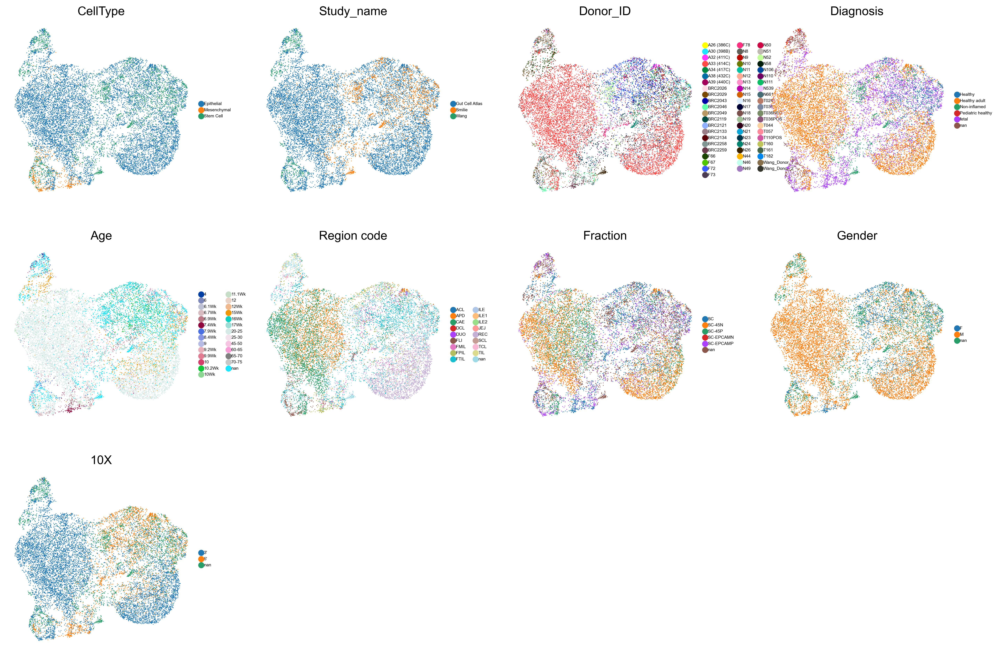

In [18]:
#Anna's plot
sc.pp.neighbors(gut_stem, use_rep = "X_scVI", n_neighbors = 50, metric = 'minkowski')
sc.tl.umap(gut_stem, min_dist = 0.3, spread = 1, random_state = 1712)
sc.pl.umap(gut_stem, frameon = False, color = ['CellType', 'Study_name', 'Donor_ID', 'Diagnosis', 'Age', 'Region code', 'Fraction', 'Gender', '10X'], size = 3, legend_fontsize = 5, ncols = 4)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:14)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)


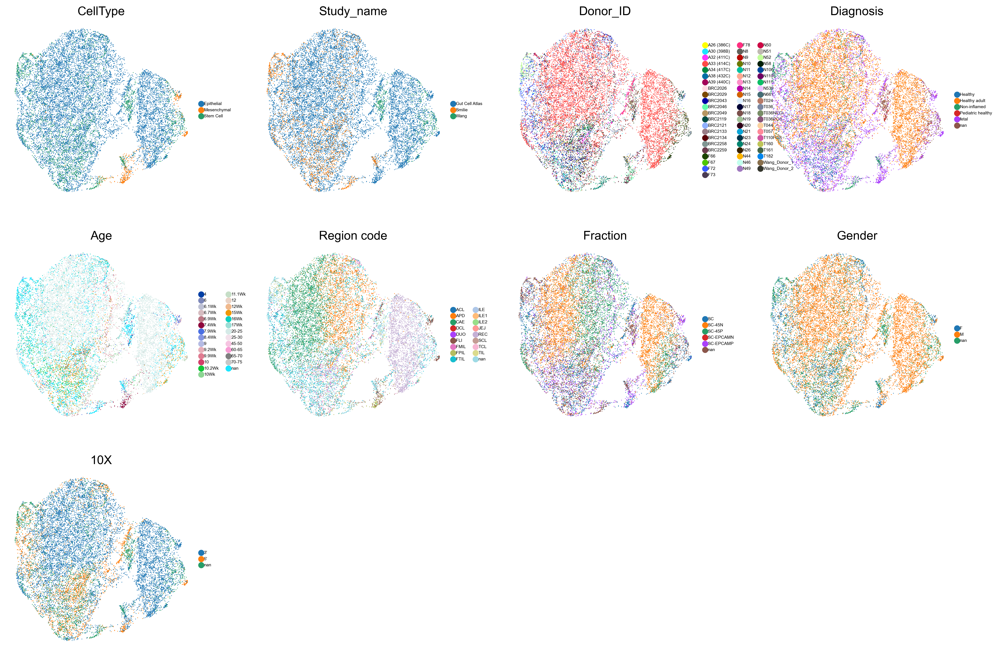

In [18]:
#Carlos' plot
sc.pp.neighbors(gut_stem, use_rep = "X_scVI", n_neighbors = 50, metric = 'minkowski')
sc.tl.umap(gut_stem, min_dist = 0.3, spread = 1, random_state = 1712)
sc.pl.umap(gut_stem, frameon = False, color = ['CellType', 'Study_name', 'Donor_ID', 'Diagnosis', 'Age', 'Region code', 'Fraction', 'Gender', '10X'], size = 3, legend_fontsize = 5, ncols = 4)

In [19]:
gut_stem.write_h5ad('/Users/anna.maguza/Desktop/Data/Processed_datasets/Predicted_stem_cells/Predicted_stem_cells_scVI.h5ad')

In [ ]:
del gut_stem

### Cluster manifold using `leiden` + `SCCAF`

In [1]:
import SCCAF
from SCCAF import SCCAF_assessment, plot_roc

In [2]:
import leidenalg

In [3]:
import scanpy as sc
import anndata
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
input = '/Users/anna.maguza/Desktop/Data/Processed_datasets/Predicted_stem_cells/Predicted_stem_cells_scVI.h5ad'
gut_stem = sc.read_h5ad(input)

In [5]:
sc.tl.leiden(gut_stem, resolution = 0.12, random_state = 1786)

Mean CV accuracy: 0.8533
Accuracy on the training set: 1.0000
Accuracy on the hold-out set: 0.8543


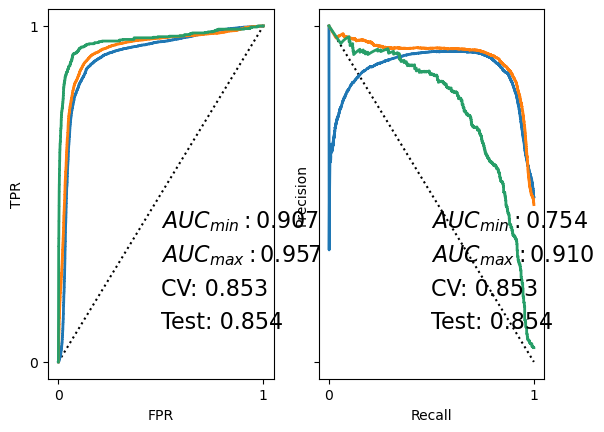

In [6]:
#Anna's plot
y_prob, y_pred, y_test, clf, cvsm, acc = SCCAF_assessment(gut_stem.X, gut_stem.obs['leiden'], n = 100)
plot_roc(y_prob, y_test, clf, cvsm = cvsm, acc = acc)
plt.show()

/Users/anna.maguza/miniconda3/envs/sccaf_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/anna.maguza/miniconda3/envs/sccaf_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/anna.maguza/miniconda3/envs/sccaf_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/anna.maguza/miniconda3/envs/sccaf_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/anna.maguza/miniconda3/envs/sccaf_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterp

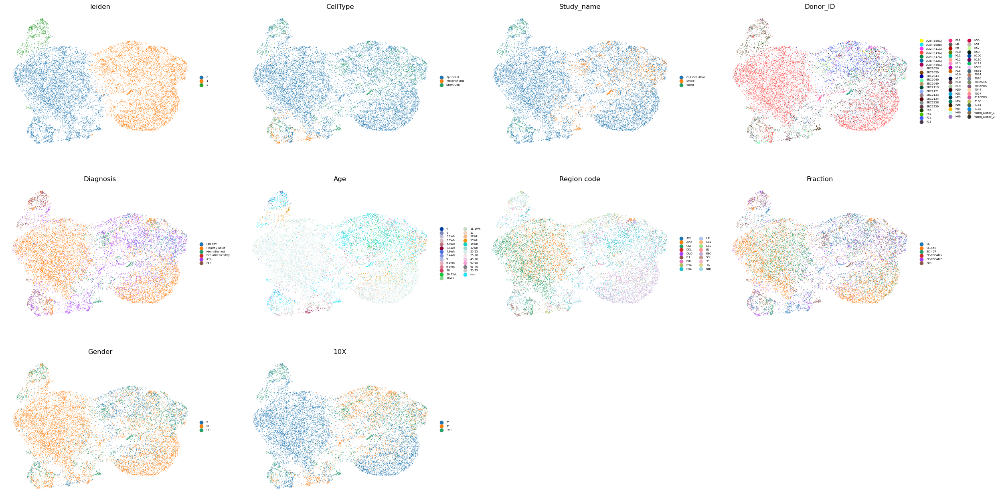

In [9]:
#Anna's plot
sc.pl.umap(gut_stem, frameon = False, color = ['leiden', 'CellType', 'Study_name', 'Donor_ID', 'Diagnosis', 'Age', 'Region code', 'Fraction', 'Gender', '10X'], size = 3, legend_fontsize = 5, ncols = 4)

In [8]:
gut_stem.write_h5ad('/Users/anna.maguza/Desktop/Data/Processed_datasets/Predicted_stem_cells/Predicted_stem_cells_post_leiden.h5ad')